In [1]:
import pandas as pd

from plotly.graph_objects import Figure, Histogram, Bar, Scatter, Heatmap
from plotly.subplots import make_subplots

In [3]:
# Cast timestamp column to pd.timestamp
df['timestamp'] = pd.to_datetime(df['timestamp'], format='%Y-%m-%d %H:%M:%S')

In [4]:
df.dtypes

site_id                        int64
timestamp             datetime64[ns]
air_temperature              float64
cloud_coverage               float64
dew_temperature              float64
precip_depth_1_hr            float64
sea_level_pressure           float64
wind_direction               float64
wind_speed                   float64
dtype: object

In [5]:
df.isnull().sum()

site_id                   0
timestamp                 0
air_temperature          55
cloud_coverage        69173
dew_temperature         113
precip_depth_1_hr     50289
sea_level_pressure    10618
wind_direction         6268
wind_speed              304
dtype: int64

In [6]:
df.describe()

,site_id,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed
count,139773.000000,139718.000000,70600.000000,139660.000000,89484.000000,129155.000000,133505.000000,139469.000000
mean,7.478977,14.418106,2.149306,7.350158,0.983047,1016.158038,180.526632,3.560527
std,4.604744,10.626595,2.599150,9.790235,8.463678,7.629684,111.523629,2.335874
min,0.000000,-28.900000,0.000000,-35.000000,-1.000000,968.200000,0.000000,0.000000
25%,3.000000,7.200000,0.000000,0.600000,0.000000,1011.800000,80.000000,2.100000
50%,7.000000,15.000000,2.000000,8.300000,0.000000,1016.400000,190.000000,3.100000
75%,11.000000,22.200000,4.000000,14.400000,0.000000,1020.800000,280.000000,5.000000
max,15.000000,47.200000,9.000000,26.100000,343.000000,1045.500000,360.000000,19.000000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139773 entries, 0 to 139772
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   site_id             139773 non-null  int64         
 1   timestamp           139773 non-null  datetime64[ns]
 2   air_temperature     139718 non-null  float64       
 3   cloud_coverage      70600 non-null   float64       
 4   dew_temperature     139660 non-null  float64       
 5   precip_depth_1_hr   89484 non-null   float64       
 6   sea_level_pressure  129155 non-null  float64       
 7   wind_direction      133505 non-null  float64       
 8   wind_speed          139469 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(1)
memory usage: 9.6 MB


In [8]:
df['site_id'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15])

### Air temperature

In [9]:
df['air_temperature'].isnull().sum()

55

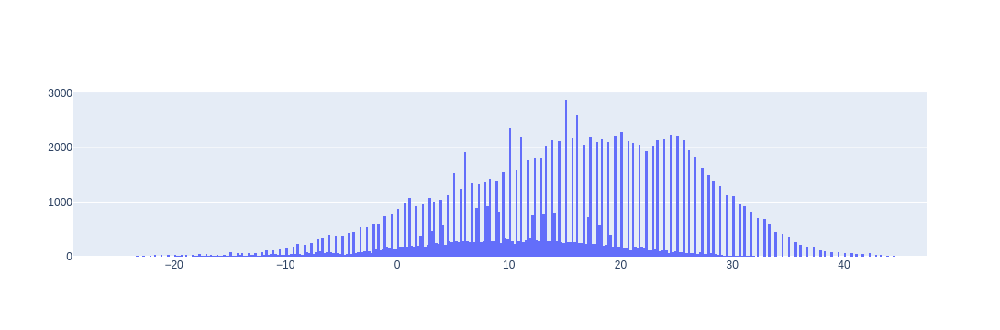

In [23]:
fig = Figure([
    Histogram(x=df['air_temperature'])
])

fig.show()

(8784, 8)


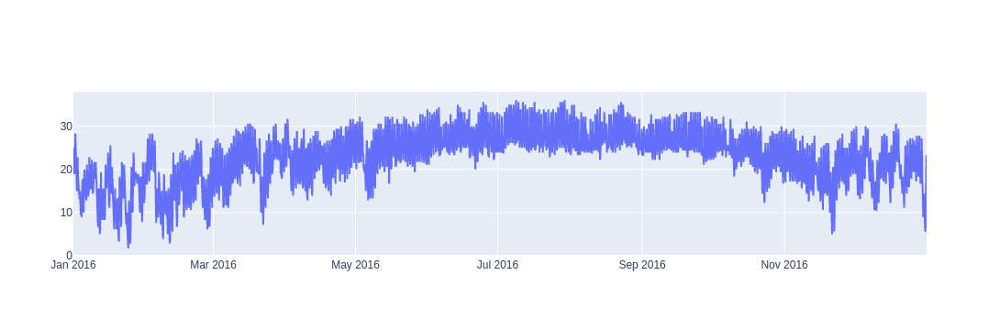

In [11]:
i = 0

data = df.query('site_id == @i', engine='python').set_index('timestamp').sort_index()

print(data.shape)

fig = Figure([
    Scatter(x=data.index, y=data['air_temperature'])
])

fig.show()

Information about Site 0
(8784, 8)
22.83602095433322
23.9


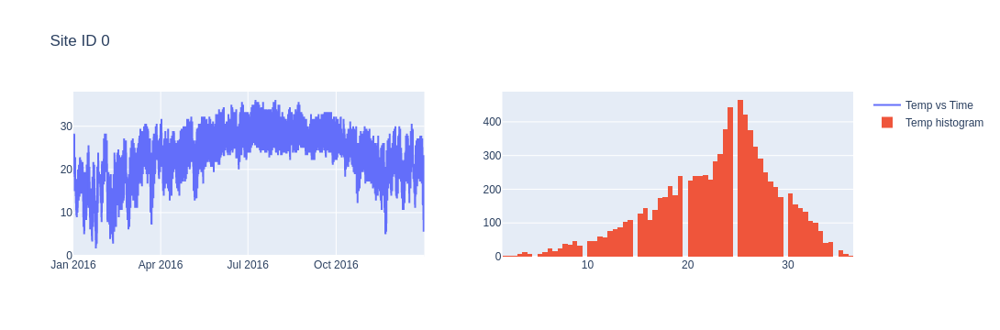

Information about Site 1
(8763, 8)
11.711800958685231
11.3


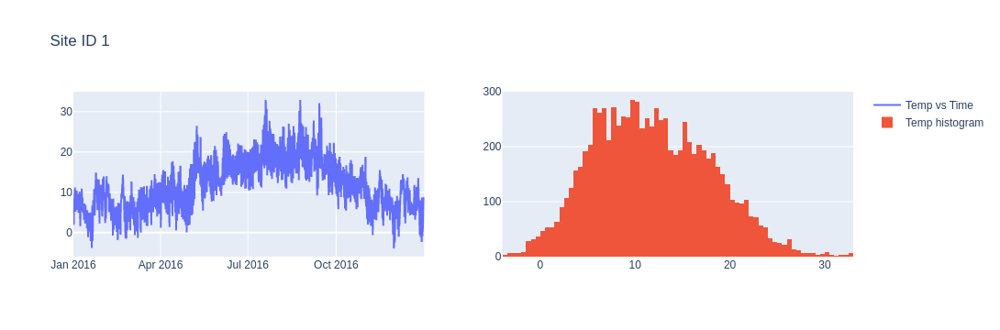

Information about Site 2
(8783, 8)
24.940321111364156
25.6


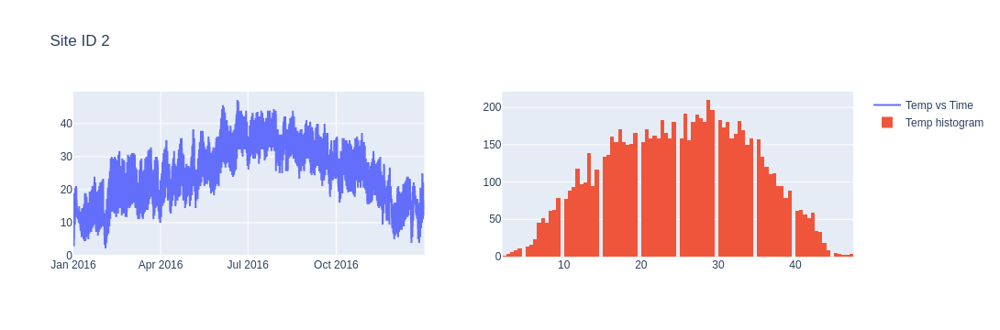

Information about Site 3
(8780, 8)
15.520578851412948
15.6


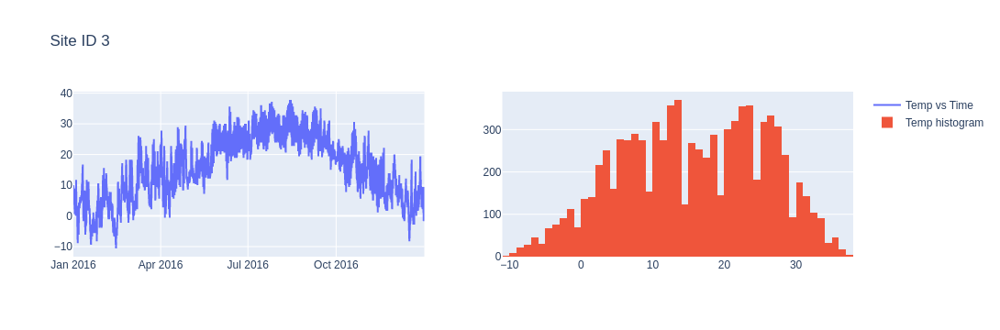

Information about Site 4
(8783, 8)
15.236365706478423
15.0


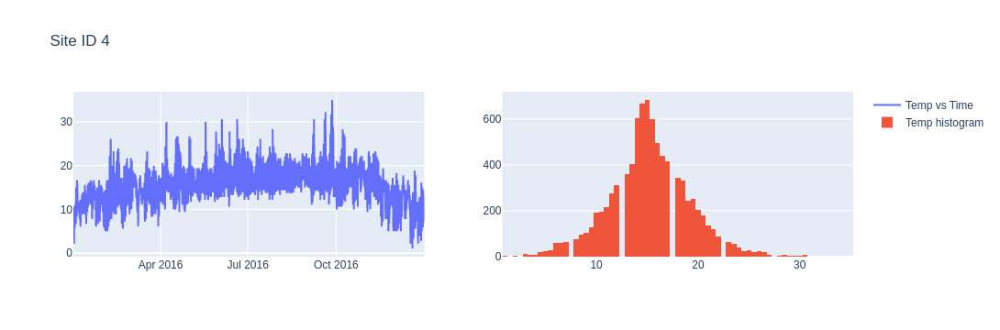

Information about Site 5
(8755, 8)
10.867930995087399
11.0


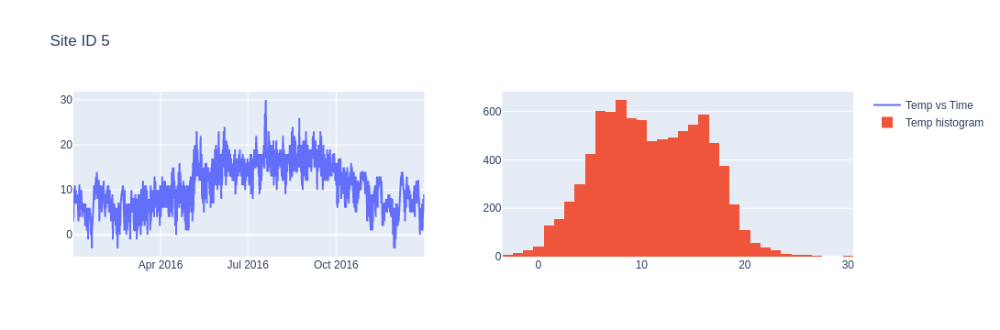

Information about Site 6
(8782, 8)
15.141678066575466
16.1


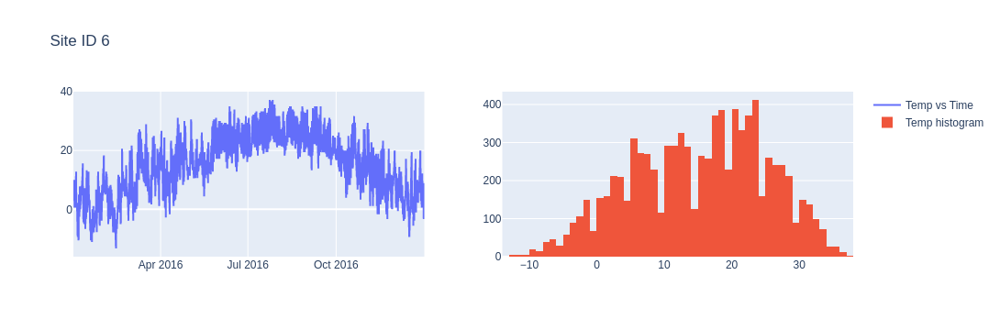

Information about Site 7
(8614, 8)
7.8888669607615505
7.7


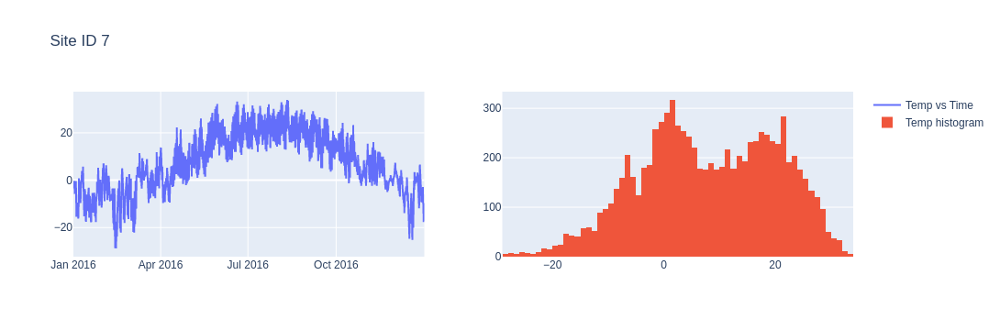

Information about Site 8
(8784, 8)
22.83602095433322
23.9


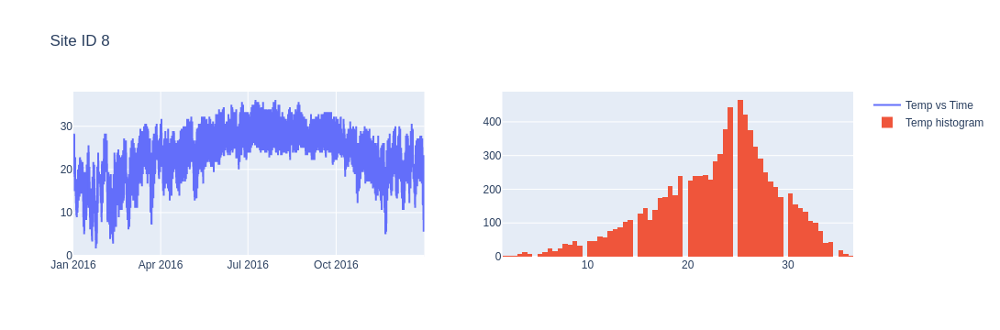

Information about Site 9
(8780, 8)
21.367498575498573
22.2


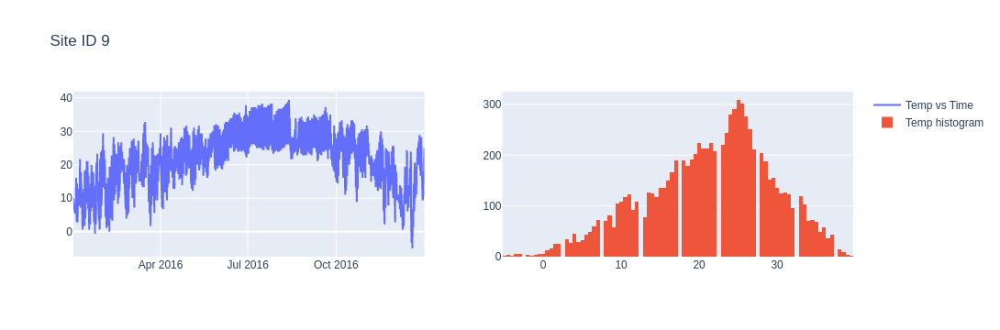

Information about Site 10
(8782, 8)
11.644679150490978
11.7


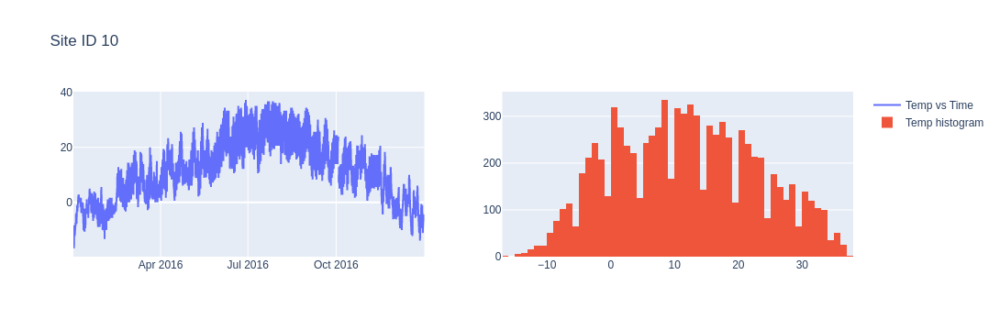

Information about Site 11
(8614, 8)
7.8888669607615505
7.7


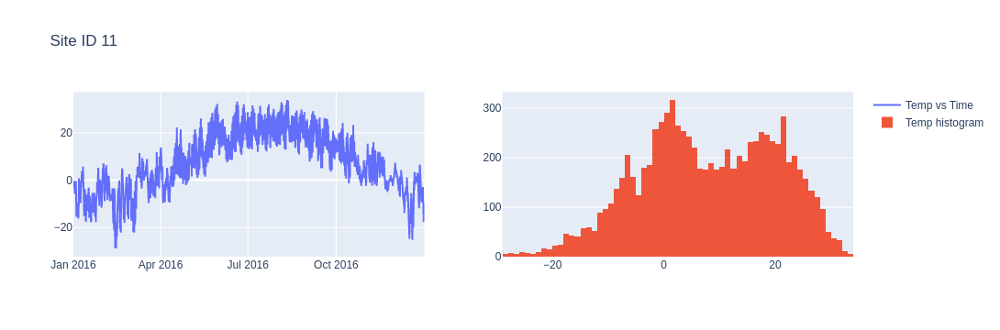

Information about Site 12
(8755, 8)
9.84323243860651
9.8


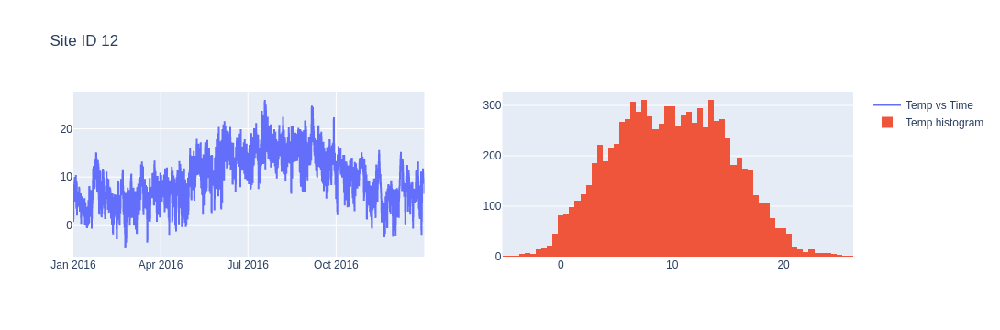

Information about Site 13
(8783, 8)
9.879617399225689
11.1


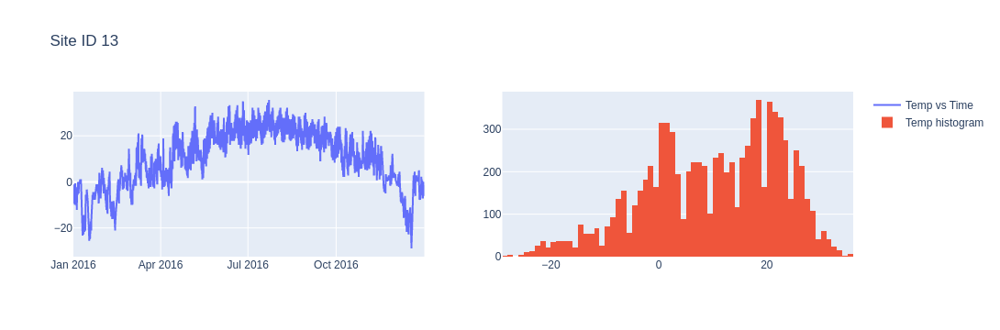

Information about Site 14
(8777, 8)
13.25840929808569
13.3


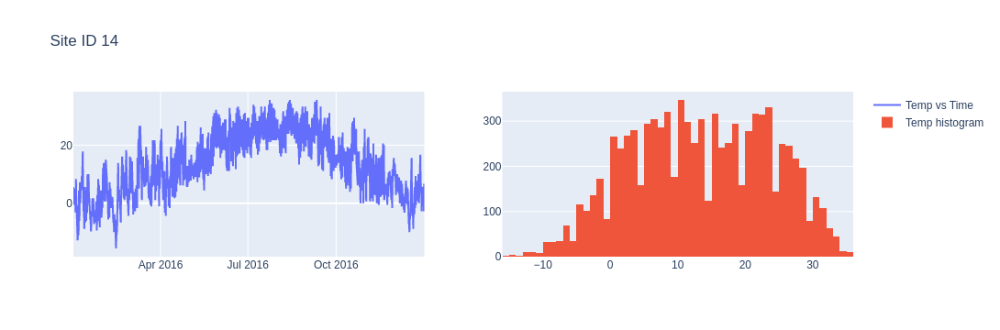

Information about Site 15
(8454, 8)
9.357617695765319
9.4


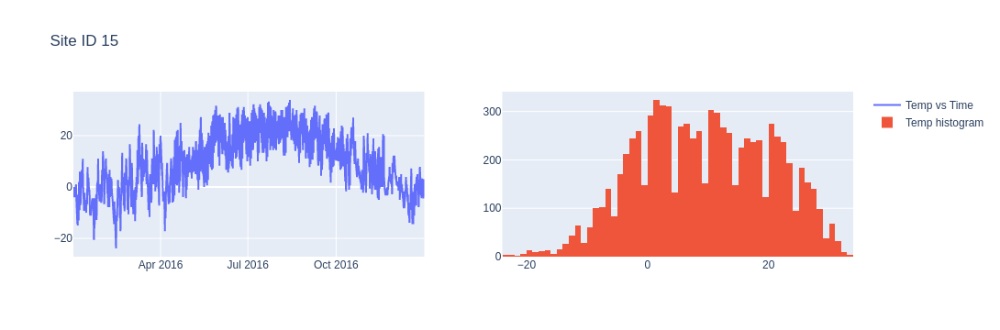

In [12]:
for i in df['site_id'].unique():
    data = df.query('site_id == @i', engine='python').set_index('timestamp').sort_index()

    print(f'Information about Site {i}')
    print(data.shape)
    print(data['air_temperature'].mean())
    print(data['air_temperature'].median())
    fig = make_subplots(rows=1, cols=2)
    fig.add_trace(
        Scatter(x=data.index, y=data['air_temperature'], name='Temp vs Time'),
        row=1, col=1
    )
    fig.add_trace(
        Histogram(x=data['air_temperature'], name='Temp histogram'),
        row=1, col=2
    )
    fig.update_layout(title=f'Site ID {i}')
    fig.show()

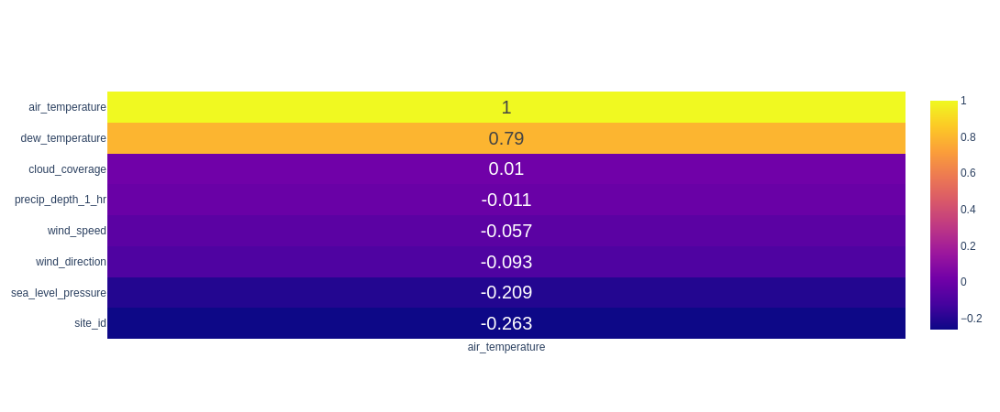

In [16]:
air_temp_corr = df.corr()[['air_temperature']].sort_values(by=['air_temperature'])

fig = Figure(data=Heatmap(
    z = air_temp_corr, 
    y = air_temp_corr.index,
    x = air_temp_corr.columns,
    text = air_temp_corr.round(3),
    texttemplate="%{text}",
    textfont={"size":20}
))

fig.update_layout(
    autosize=False,
    width=450,
    height=450,
)


fig.show()

In [22]:
# fig = Figure([
#     Scatter(x=df['air_temperature'], y=df['sea_level_pressure'], mode="markers")
# ])

# fig.show()

### Cloud coverage

In [27]:
print(f'Total rows number: {len(df)}')

null_values = df['cloud_coverage'].isnull().sum()

print(f'Total missing values in cloud_coverage: {null_values}.')

print(f'That represents {round(null_values/len(df)*100, 2)}%')

Total rows number: 139773
Total missing values in cloud_coverage: 69173.
That represents 49.49%


In [31]:
print(f'Unique values for cloud_coverage: {df["cloud_coverage"].dropna().sort_values().unique()}')

Unique values for cloud_coverage: [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.]


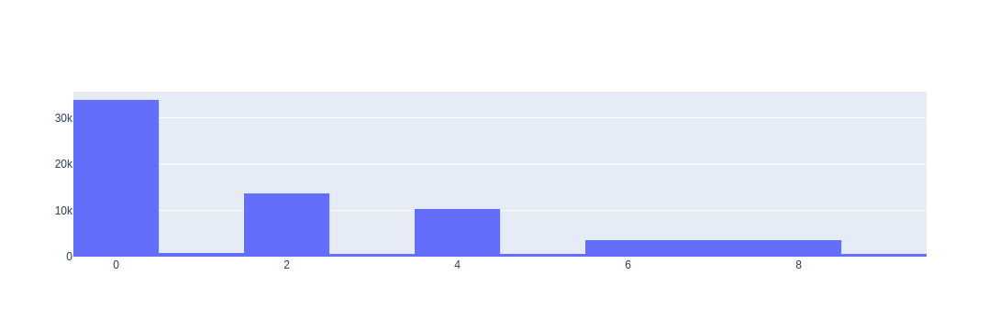

In [28]:
fig = Figure([
    Histogram(x=df['cloud_coverage'])
])

fig.show()

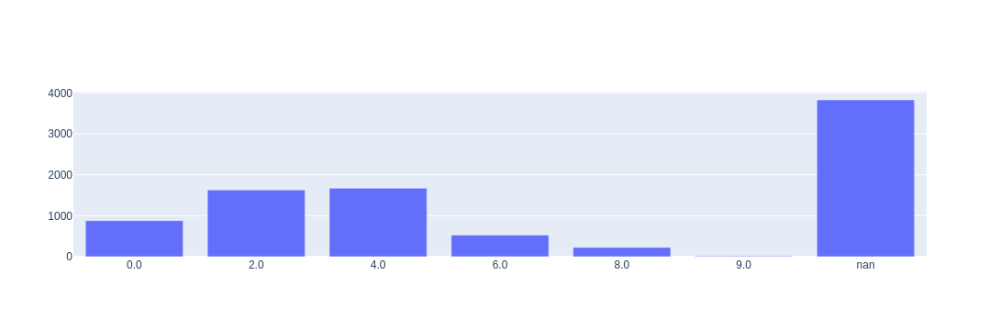

In [48]:
i = 0

data = (
    df
    .query('site_id == @i', engine='python')
    .astype({'cloud_coverage': str})
    .groupby('cloud_coverage')
    .size()
)

fig=Figure([
    Bar(x=data.index, y=data)
])

fig.show()

Information about Site 0


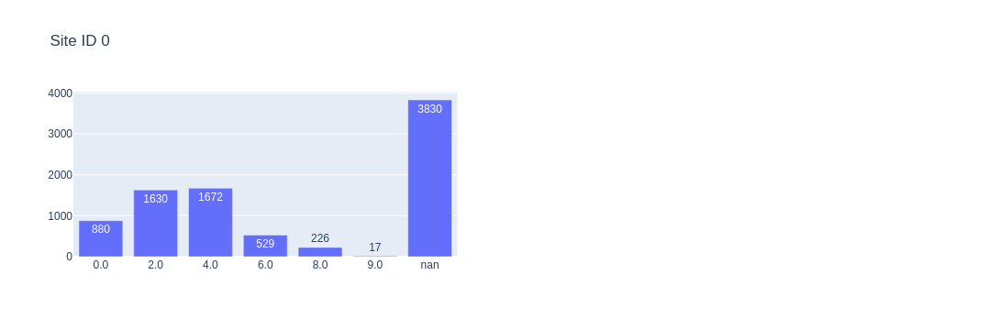

Information about Site 1


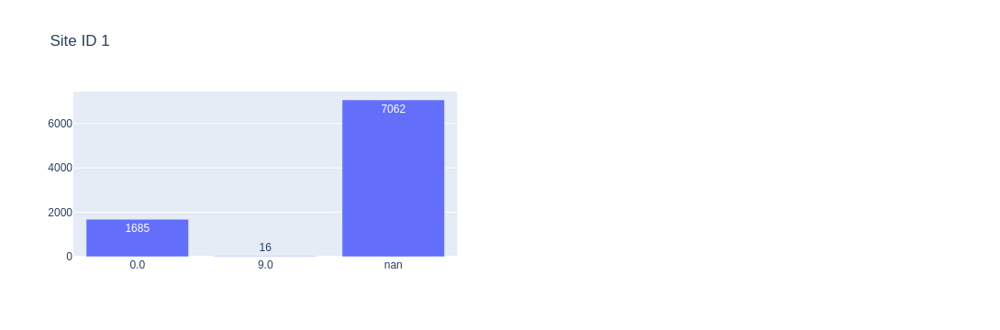

Information about Site 2


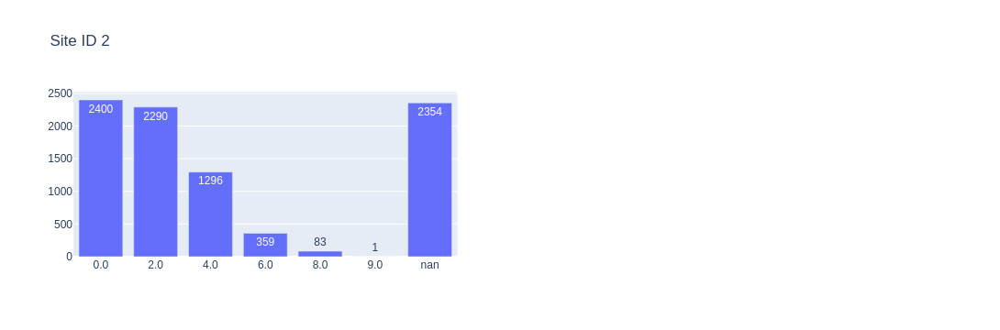

Information about Site 3


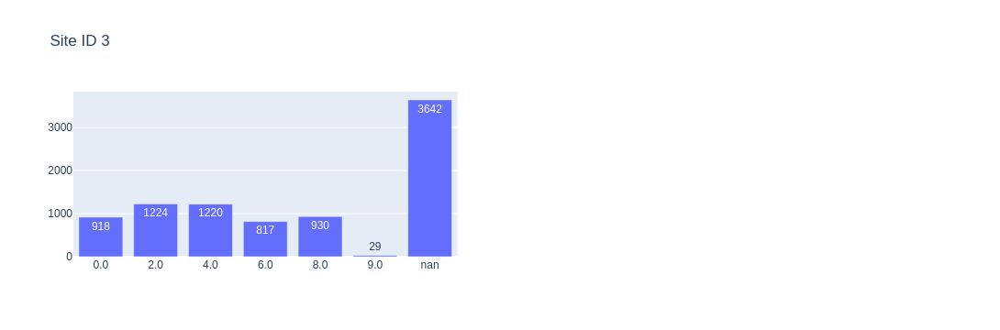

Information about Site 4


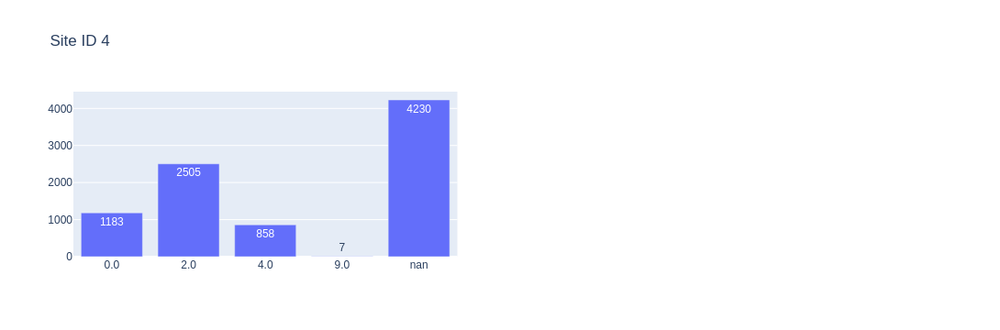

Information about Site 5


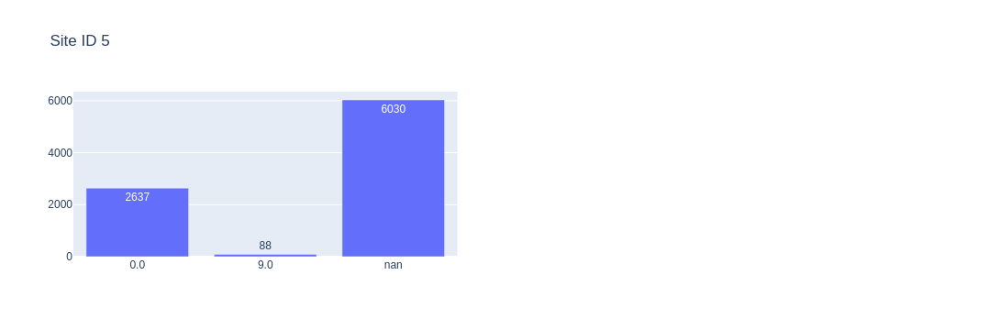

Information about Site 6


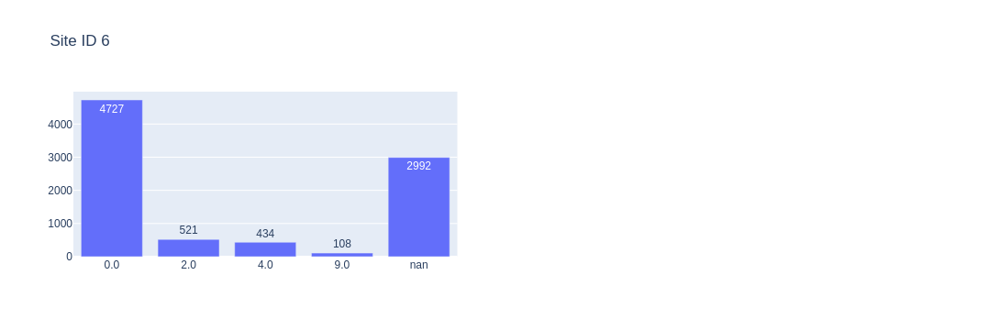

Information about Site 7


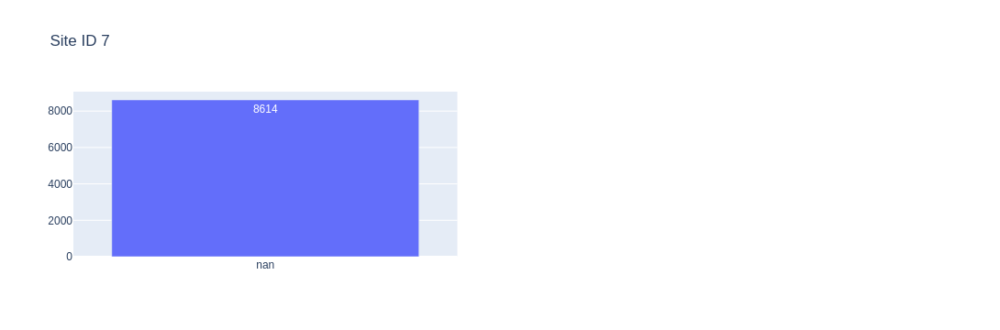

Information about Site 8


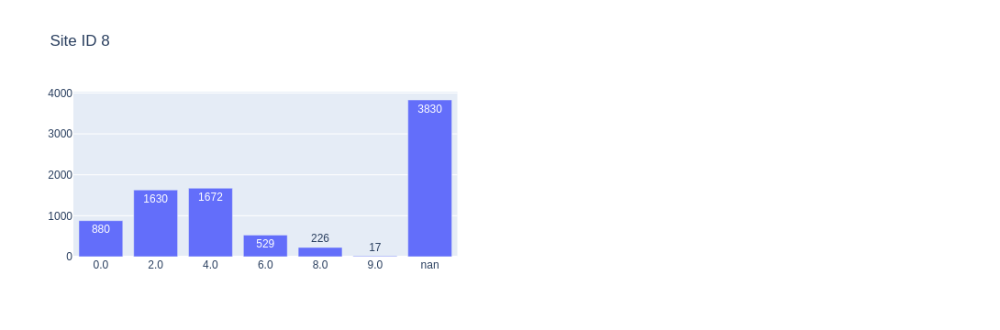

Information about Site 9


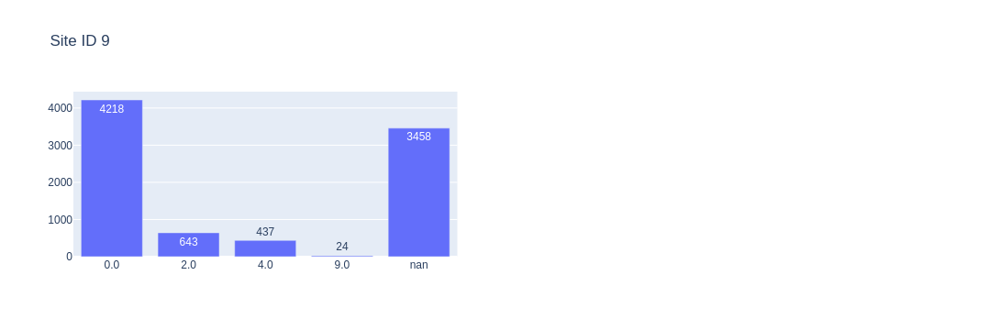

Information about Site 10


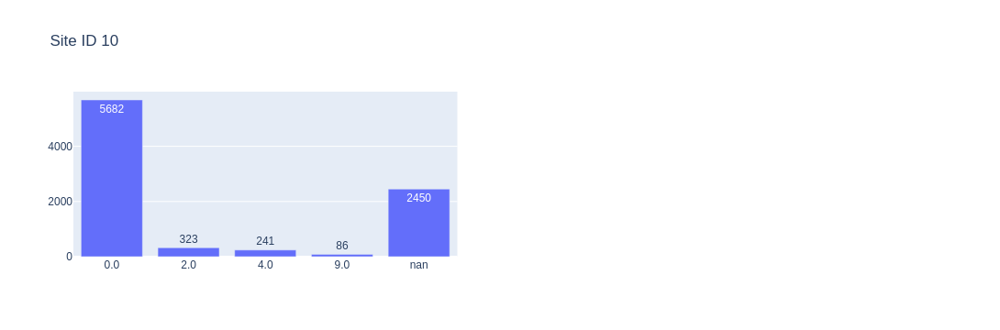

Information about Site 11


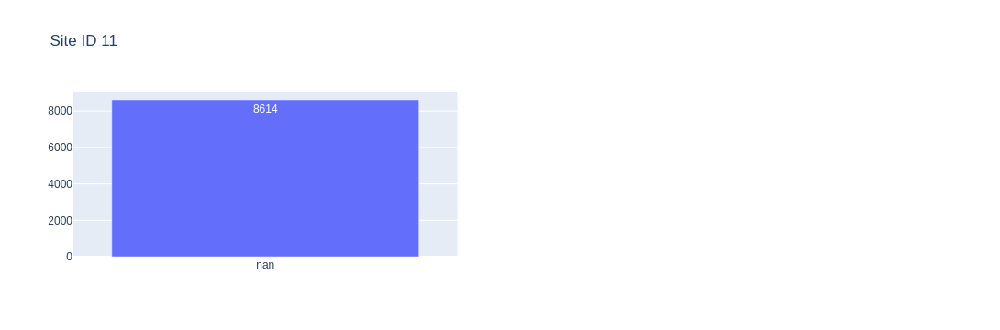

Information about Site 12


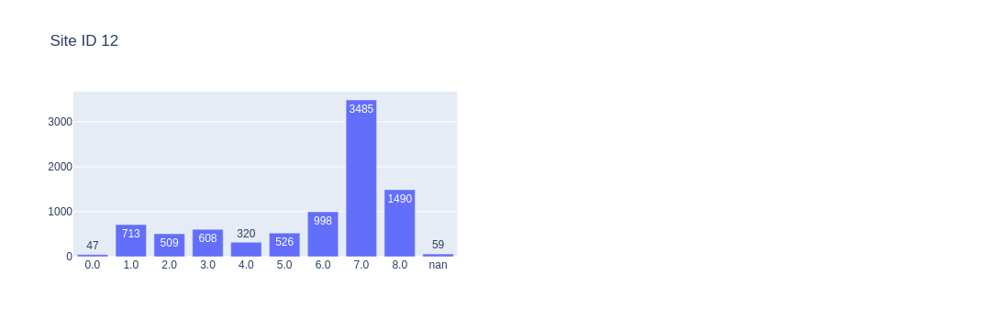

Information about Site 13


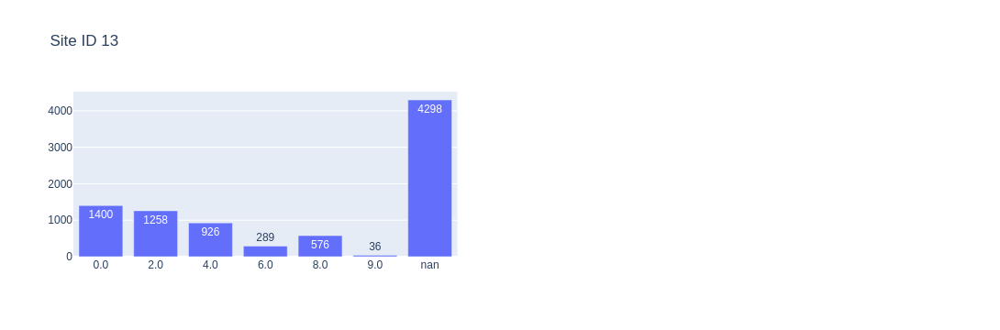

Information about Site 14


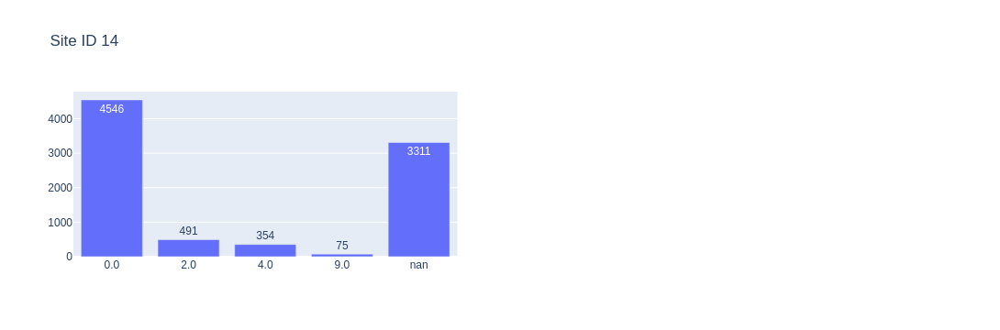

Information about Site 15


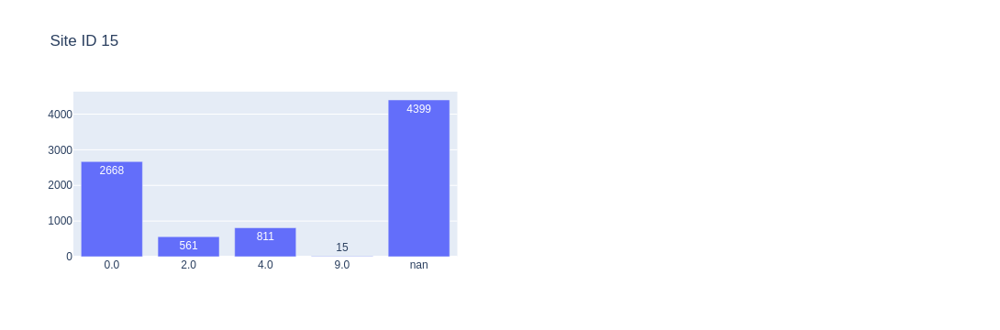

In [51]:
for i in df['site_id'].unique():
    data = (
        df
        .query('site_id == @i', engine='python')
        .astype({'cloud_coverage': str})
        .groupby('cloud_coverage')
        .size()
    )

    print(f'Information about Site {i}')
    fig = make_subplots(rows=1, cols=2)
    fig.add_trace(
        Bar(
            x=data.index,
            y=data,
            text=data,
            textposition='auto',
            name='Cloud coverage distribution'
        ),
        row=1, col=1
    )
    # fig.add_trace(
    #     Histogram(x=data['cloud_coverage'], name='Temp histogram'),
    #     row=1, col=2
    # )
    fig.update_layout(title=f'Site ID {i}')
    fig.show()

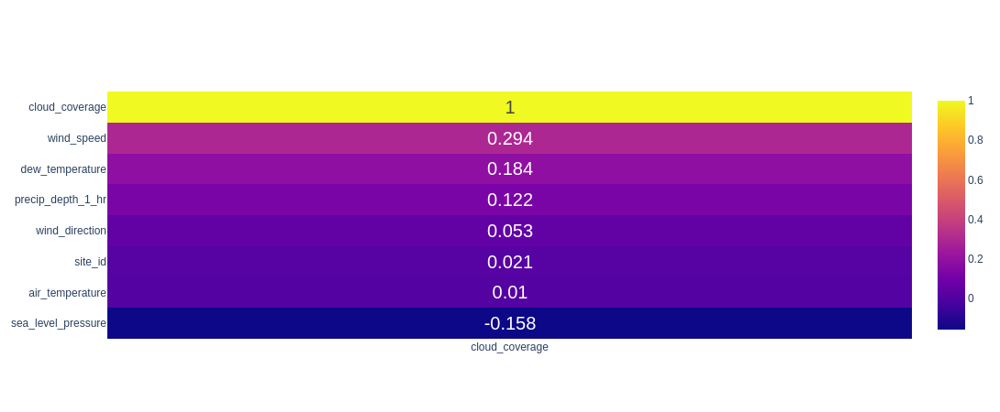

In [52]:
air_temp_corr = df.corr()[['cloud_coverage']].sort_values(by=['cloud_coverage'])

fig = Figure(data=Heatmap(
    z = air_temp_corr, 
    y = air_temp_corr.index,
    x = air_temp_corr.columns,
    text = air_temp_corr.round(3),
    texttemplate="%{text}",
    textfont={"size":20}
))

fig.update_layout(
    autosize=False,
    width=450,
    height=450,
)


fig.show()